In [1]:
!del /Q utils\__pycache__

In [2]:
import pandas as pd
from tqdm.notebook import tqdm

In [3]:
from utils.datasets import GhlKasperskyDataset, TepHarvardDataset, TepKasperskyDataset
from utils.custom_plots import plot_stacked

In [4]:
from utils.metrics import time_span_metrics

In [5]:
from utils.watchmen import PcaLimitWatchman

## GHL

In [6]:
ds = GhlKasperskyDataset()
ds.shake_not_stir()

In [7]:
watchman = PcaLimitWatchman(n_components=3)

In [8]:
train_gen = ds.train_generator()
for data, _, _ in tqdm(train_gen):
    watchman.prefit(data)

  0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
train_gen = ds.train_generator()
for data, faults, info in tqdm(train_gen):
    watchman.fit(data)

  0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
train_gen = ds.train_generator()
for data, faults, info in tqdm(train_gen):
    watchman.postfit(data)

  0%|          | 0/1 [00:00<?, ?it/s]

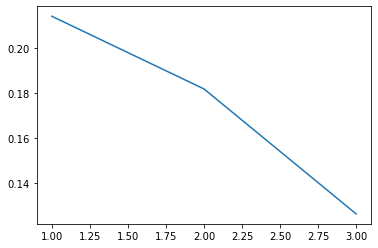

In [11]:
watchman.explain_transformer().plot();

In [12]:
test_gen = ds.test_generator()
examine_list = pd.DataFrame(columns=['precision', 'recall', 'f1_score'], dtype='float')
for data, faults, info in tqdm(test_gen, total=48):
    detect = watchman.predict(data)
    examine_list.loc[info] = time_span_metrics(faults, detect)
#     if max(faults) and max(detect):
#         break

  0%|          | 0/48 [00:00<?, ?it/s]

In [13]:
examine_list.mean()

precision    0.507500
recall       0.377034
f1_score     0.388211
dtype: float64

In [14]:
plot_stacked(data,
             title=info,
             group='value_unit',
             faults=faults,
             detect=detect,
            )

## TEP Harvard

In [15]:
ds = TepHarvardDataset()
ds.shake_not_stir()

In [16]:
watchman = PcaLimitWatchman(n_components=12)

In [17]:
train_gen = ds.train_generator()
for data, _, _ in tqdm(train_gen):
    watchman.prefit(data)

  0%|          | 0/500 [00:00<?, ?it/s]

In [18]:
train_gen = ds.train_generator()
for data, faults, info in tqdm(train_gen, total=500):
    watchman.fit(data)

  0%|          | 0/500 [00:00<?, ?it/s]

In [19]:
train_gen = ds.train_generator()
for data, faults, info in tqdm(train_gen):
    watchman.postfit(data)

  0%|          | 0/500 [00:00<?, ?it/s]

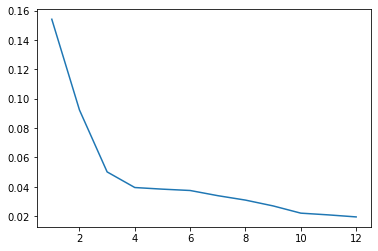

In [20]:
watchman.explain_transformer().plot();

In [21]:
test_gen = ds.valid_generator()
examine_list = pd.DataFrame(columns=['precision', 'recall', 'f1_score'], dtype='float')
for data, faults, info in tqdm(test_gen):
    detect = watchman.predict(data)
    examine_list.loc[info] = time_span_metrics(faults, detect)
#     if max(faults) and max(detect) and 'fault_001' in info:
#         break;

  0%|          | 0/3150 [00:00<?, ?it/s]

In [22]:
examine_list.mean()

precision    1.000000
recall       0.576842
f1_score     0.618751
dtype: float64

In [23]:
plot_stacked(data,
             title=info,
             group='value_unit',
             faults=faults,
             detect=detect,
            )

## TEP Kaspersky

In [24]:
ds = TepKasperskyDataset()
ds.shake_not_stir()

In [25]:
watchman = PcaLimitWatchman(n_components=3)

In [26]:
train_gen = ds.train_generator()
for data, _, _ in tqdm(train_gen):
    watchman.prefit(data)

  0%|          | 0/400 [00:00<?, ?it/s]

In [28]:
train_gen = ds.train_generator()
for data, faults, info in tqdm(train_gen, total=400):
    watchman.fit(data)

  0%|          | 0/400 [00:00<?, ?it/s]

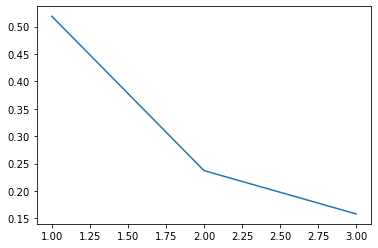

In [30]:
watchman.explain_transformer().plot();

In [31]:
train_gen = ds.train_generator()
for data, faults, info in tqdm(train_gen):
    watchman.postfit(data)

  0%|          | 0/400 [00:00<?, ?it/s]

In [32]:
test_gen = ds.valid_generator()
examine_list = pd.DataFrame(columns=['precision', 'recall', 'f1_score'], dtype='float')
for data, faults, info in tqdm(test_gen):
    detect = watchman.predict(data)
    examine_list.loc[info] = time_span_metrics(faults, detect)
#     if max(faults) and max(detect) and 'fault_001' in info:
#         break;

  0%|          | 0/146 [00:00<?, ?it/s]

In [33]:
examine_list.mean()

precision    0.952381
recall       0.206884
f1_score     0.213077
dtype: float64

In [34]:
plot_stacked(data,
             title=info,
             group='value_unit',
             faults=faults,
             detect=detect,
            )